# Mini Project 3 – Art Analysis

In [ ]:
!pip install pyvis

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 756.0/756.0 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 26.5 MB/s eta 0:00:00


### Import Libraries

In [ ]:
# Import necessary libraries
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from networkx.algorithms import community
import matplotlib.patches as mpatches
from collections import Counter
from IPython.core.display import HTML, display
from matplotlib.lines import Line2D
from pyvis.network import Network


### Load data

In [ ]:
# Load data from CSV files
artists_df = pd.read_csv('/content/artists.csv')
relationships_df = pd.read_csv('/content/relationships.csv')
institutions_df = pd.read_csv('/content/institutions.csv')
schools_df = pd.read_csv('/content/schools.csv')


### Explore data

In [ ]:
artists_df.columns

Index(['artistUrl', 'id', 'image', 'nation', 'title', 'totalWorksTitle',
       'year'],
      dtype='object')

In [ ]:
artists_df.shape

(2996, 7)

In [ ]:
artists_df.isna().sum()

,0
artistUrl,0
id,0
image,0
nation,32
title,0
totalWorksTitle,0
year,1


In [ ]:
artists_df['nation'].value_counts()

,count
nation,
American,520
French,402
Italian,269
British,249
German,160
...,...
Italians,1
Bangladeshis,1
Romanians,1


### Distribution of Artist Nationalities

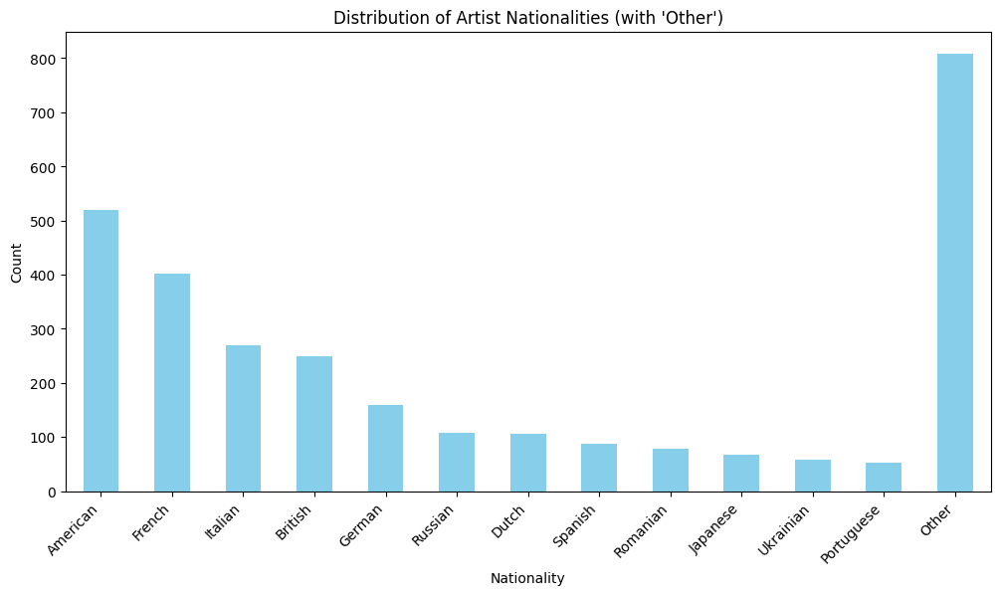

In [ ]:
nationality_counts = artists_df['nation'].value_counts()

top_nationalities = nationality_counts[nationality_counts > 50]

# Calculate the count of all other nationalities and add to "Other" category
other_count = nationality_counts[nationality_counts <= 50].sum()
top_nationalities['Other'] = other_count

# Plot the distribution
plt.figure(figsize=(12, 6))
top_nationalities.plot(kind='bar', color='skyblue')
plt.title("Distribution of Artist Nationalities (with 'Other')")
plt.xlabel("Nationality")
plt.ylabel("Count")
plt.xticks(rotation=45, ha="right")
plt.show()

In [ ]:
relationships_df.columns

Index(['artistUrl', 'friends', 'influenced_by', 'influenced_on', 'institution',
       'movements', 'school', 'type'],
      dtype='object')

In [ ]:
relationships_df.shape

(2996, 8)

In [ ]:
relationships_df.isna().sum()

,0
artistUrl,0
friends,2580
influenced_by,2512
influenced_on,2637
institution,2362
movements,40
school,1966
type,1


### Top 10 Artistic Movements

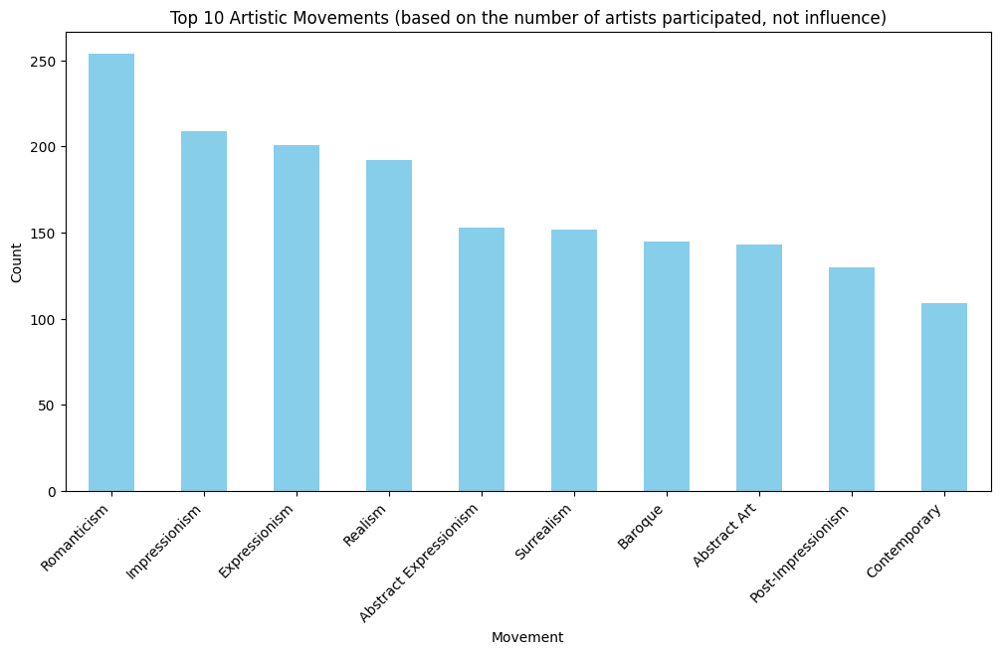

In [ ]:

# Split the 'movements' column on commas and expand it into multiple rows
movement_counts = relationships_df['movements'].str.split(',').explode()

# Now, count each unique value
movement_counts = movement_counts.value_counts()

top_movements = movement_counts.nlargest(10)

# Plot the distribution
plt.figure(figsize=(12, 6))
top_movements.plot(kind='bar', color='skyblue')
plt.title(f"Top 10 Artistic Movements (based on the number of artists participated, not influence)")
plt.xlabel("Movement")
plt.ylabel("Count")
plt.xticks(rotation=45, ha="right")
plt.show()

In [ ]:
institutions_df.columns

Index(['city', 'country', 'title', 'url'], dtype='object')

In [ ]:
institutions_df.shape

(73, 4)

### Function to clean and split comma-separated entries in a column

In [ ]:
# Function to clean and split comma-separated entries in a column
def parse_relationships(entry):
    if pd.isna(entry):
        return []
    return [item.strip() for item in entry.split(',') if item]

In [ ]:
# Unique institution values represented in the relationships csv file
unique_values = relationships_df['institution'].unique()
print(len(unique_values))

209


In [ ]:
# Get unique values from the institution 'urls' from the relationship csv file
unique_institution_urls_re = set()
for _, row in relationships_df.iterrows():
    institutions = parse_relationships(row['institution'])
    for item in institutions:
      unique_institution_urls_re.add(item)

In [ ]:
# Get unique values from the institution 'urls' from the institutions csv file
unique_institutions_urls = set(institutions_df['url'].unique())

# Count institution URLs in relationships but not in institutions
only_in_relationships_count = len(unique_institution_urls_re - unique_institutions_urls)

# Count URLs in institutions but not in relationships
only_in_institutions_count = len(unique_institutions_urls - unique_institution_urls_re)

# Print the counts
print(f"Count of institution URLs only in the relationships csv file: {only_in_relationships_count}")
print(f"Count of institution URLs only in the institutions csv file: {only_in_institutions_count}")


Count of institution URLs only in the relationships csv file: 15
Count of institution URLs only in the institutions csv file: 0


In [ ]:
institutions_df.isna().sum()

,0
city,2
country,2
title,0
url,0


In [ ]:
schools_df.columns

Index(['title', 'url'], dtype='object')

In [ ]:
schools_df.shape

(220, 2)

In [ ]:
# Get unique values from the school 'urls' from the relationship csv file
unique_schools_urls_re = set()
for _, row in relationships_df.iterrows():
    schools = parse_relationships(row['school'])
    for item in schools:
      unique_schools_urls_re.add(item)
print(len(unique_schools_urls_re))

273


In [ ]:
# Get unique values from the 'url' from the schools csv file
unique_schools_urls = set(schools_df['url'].unique())

# Calculate the differences
# Count URLs in schools but not in relationships
only_in_schools_count = len(unique_schools_urls - unique_schools_urls_re)

# Count school URLs in relationships but not in schools
only_in_relationships_count = len(unique_schools_urls_re - unique_schools_urls)

# Print the counts
print(f"Count of school URLs only in the schools csv file: {only_in_schools_count}")
print(f"Count of school URLs only in the relationships csv file: {only_in_relationships_count}")


Count of school URLs only in the schools csv file: 0
Count of school URLs only in the relationships csv file: 53


In [ ]:
schools_df.isna().sum()

,0
title,0
url,0


In [ ]:
schools = set()
movements = set()
artists = set()

for _, row in relationships_df.iterrows():
    influenced_on = parse_relationships(row['influenced_on'])
    influenced_by = parse_relationships(row['influenced_by'])
    for item in influenced_by + influenced_on:
        # Check if it follows the URL pattern
        if item.startswith("/en/artists-by-art-movement/"):
            movements.add(item)
        elif item.startswith("/en/artists-by-painting-school/"):
            schools.add(item)
        else:
            artists.add(item)
print("Number of schools, artists, and movements in the relation of influenced_on or _by")
print("Schools: ", len(schools))
print("Movements: ", len(movements))
print("Artists: ", len(artists))

Number of schools, artists, and movements in the relation of influenced_on or _by
Schools:  33
Movements:  50
Artists:  661


In [ ]:
schools_on = set()  # Use a set to avoid duplicate entries
movements_on = set()
artists_on = set()

schools_by = set()
movements_by = set()
artists_by = set()

for _, row in relationships_df.iterrows():
    influenced_by = parse_relationships(row['influenced_by'])
    for item in influenced_by:
        # Check if it follows the movement URL pattern
        if item.startswith("/en/artists-by-art-movement/"):
            movements_by.add(item)
        if item.startswith("/en/artists-by-painting-school/"):
            schools_by.add(item)
        else:
            artists_by.add(item)
for _, row in relationships_df.iterrows():
    influenced_on = parse_relationships(row['influenced_on'])

    for item in influenced_on:
        # Check if it follows the movement URL pattern
        if item.startswith("/en/artists-by-art-movement/"):
            movements_on.add(item)
        if item.startswith("/en/artists-by-painting-school/"):
            schools_on.add(item)
        else:
            artists_on.add(item)
print("Number of influenced_on")
print("Schools: ", len(schools_on))
print("Movements: ", len(movements_on))
print("Artists: ", len(artists_on))

print("\nNumber of influenced_by")
print("Schools: ", len(schools_by))
print("Movements: ", len(movements_by))
print("Artists: ", len(artists_by))

Number of influenced_on
Schools:  20
Movements:  33
Artists:  513

Number of influenced_by
Schools:  22
Movements:  35
Artists:  396


### Initialize a Directed Graph

In [ ]:
# Initialize a directed graph
G = nx.DiGraph()


### Split comma-separated entries

In [ ]:
# Function to clean and split comma-separated entries in influenced_by and influenced_on
def parse_relationships(entry):
    if pd.isna(entry):
        return []
    return [item.strip() for item in entry.split(',') if item]


### Identify node for the influence

In [ ]:
# Function to identify the type of node based on URL pattern
def get_node_type(url):
    if url.startswith("/en/artists-by-art-movement/"):
        return 'movement'
    elif url.startswith("/en/artists-by-painting-school/"):
        return 'school'
    return 'artist'


### Add the nodes to the graph

In [ ]:
schools = set()
movements = set()
artists = set()

for _, row in relationships_df.iterrows():
    influenced_on = parse_relationships(row['influenced_on'])
    influenced_by = parse_relationships(row['influenced_by'])
    for item in influenced_by + influenced_on:
        # if the influencere or influenced actor is not in the artists set, add to the set
        artists.add(row['artistUrl'])
        # Check if it follows the URL pattern
        if item.startswith("/en/artists-by-art-movement/"):
            movements.add(item)
        elif item.startswith("/en/artists-by-painting-school/"):
            schools.add(item)
        else:
            artists.add(item)

# Add each unique movement as a node in the graph
for movement in movements:
    G.add_node(movement, type='movement', name=movement)

# Add each unique school as a node in the graph
for school in schools:
    G.add_node(school, type='school', name=school)

# Filter the artists DataFrame to include only those in the 'artists' set
filtered_artists_df = artists_df[artists_df['artistUrl'].isin(artists)]

# Add artist nodes to the graph with attributes from the filtered artists DataFrame
for _, row in filtered_artists_df.iterrows():
    artist_url = row['artistUrl']  # Unique identifier for the artist

    # Add the artist node with all relevant attributes
    G.add_node(
        artist_url,  # artistUrl as a unique identifier for the artist
        type='artist',
        nation=row['nation'],
        total_artworks=row['totalWorksTitle'],
        active_years=row['year'],
        image_url=row['image'],
        id=row['id'],
        title=row['title'],
        url=artist_url
    )

# Some of the artists in the influence_on and _by are not in the artists csv file or artists dataframe
artists_from_csv = set(artists_df['artistUrl'])
missing_artists = artists - artists_from_csv

for artist_url in missing_artists:
    G.add_node(artist_url, type='artist')



### Add the edges to the graph

In [ ]:
# Add edges based on influence relationships in relationships.csv
for _, row in relationships_df.iterrows():
    artist_id = row['artistUrl']

    # Process the "influenced by" column
    influenced_by = parse_relationships(row['influenced_by'])  # Split and clean the influenced_by column
    for influencer in influenced_by:
        influencer_type = get_node_type(influencer)  # Identify if it's a school, movement, or artist
        if G.has_node(influencer) and influencer_type:  # Check if the influencer node already exists in the graph
            # Add a directed edge from influencer to artist_id
            G.add_edge(influencer, artist_id, type=influencer_type, relationship='influenced_by')

    # Process the "influenced on" column
    influenced_on = parse_relationships(row['influenced_on'])
    for influencee in influenced_on:
        influencee_type = get_node_type(influencee)
        if G.has_node(influencee) and influencee_type:
            # Add a directed edge from artist_id to influencee
            G.add_edge(artist_id, influencee, type=influencee_type, relationship='influenced_on')


### Drawing the graph

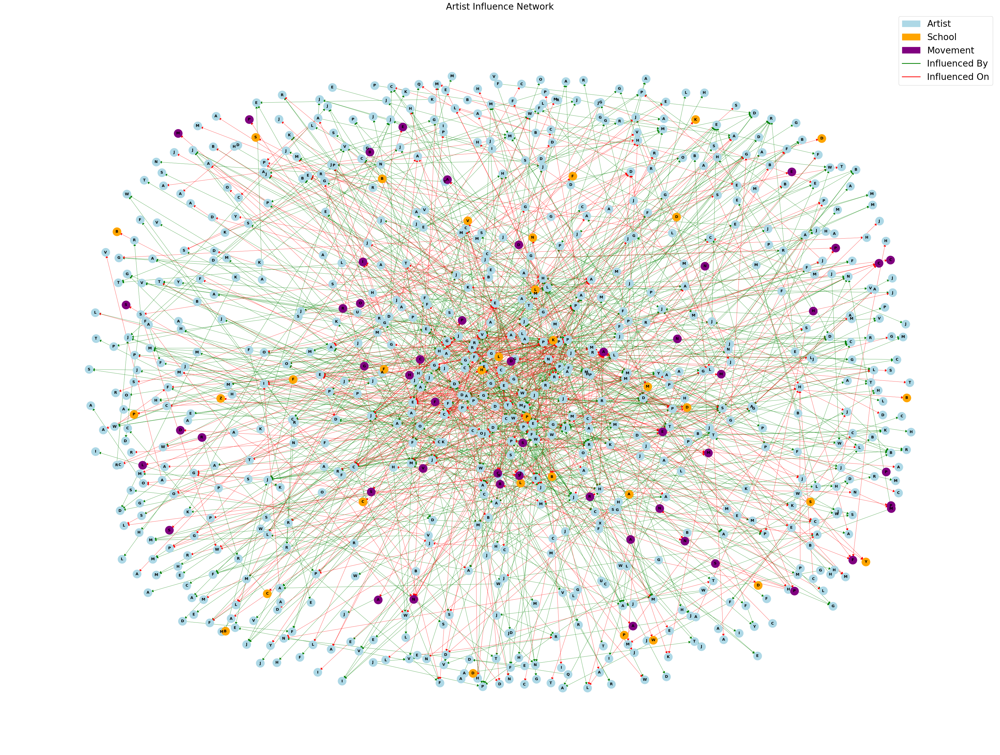

In [ ]:
# Use spring layout for better visualization of directed relationships
pos = nx.spring_layout(G, k=0.15, iterations=20)
plt.figure(figsize=(48, 36))

# Separate nodes by type
artist_nodes = [node for node, data in G.nodes(data=True) if data.get('type') == 'artist']
school_nodes = [node for node, data in G.nodes(data=True) if data.get('type') == 'school']
movement_nodes = [node for node, data in G.nodes(data=True) if data.get('type') == 'movement']

# Draw nodes by type with distinct colors
nx.draw_networkx_nodes(G, pos, nodelist=artist_nodes, node_color='lightblue', node_size=500, label="Artist")
nx.draw_networkx_nodes(G, pos, nodelist=school_nodes, node_color='orange', node_size=500, label="School")
nx.draw_networkx_nodes(G, pos, nodelist=movement_nodes, node_color='purple', node_size=500, label="Movement")

# Separate edges by relationship type
influenced_by_edges = [(u, v) for u, v, d in G.edges(data=True) if d.get('relationship') == 'influenced_by']
influenced_on_edges = [(u, v) for u, v, d in G.edges(data=True) if d.get('relationship') == 'influenced_on']

# Draw edges by type with different colors
nx.draw_networkx_edges(G, pos, edgelist=influenced_by_edges, edge_color='green', width=0.5, arrows=True, arrowsize=15, label="Influenced By")
nx.draw_networkx_edges(G, pos, edgelist=influenced_on_edges, edge_color='red', width=0.5, arrows=True, arrowsize=15, label="Influenced On")

# Prepare labels based on node type
labels = {}
for node in artist_nodes:
        labels[node] = node.replace('/en/', '').capitalize()[0]  # First character for artist names
for node in school_nodes:
    labels[node] = node.replace('/en/artists-by-painting-school/', '').capitalize()[0]  # First character for school names
for node in movement_nodes:
    labels[node] = node.replace('/en/artists-by-art-movement/', '').capitalize()[0] # First character for movement names

# Draw labels
nx.draw_networkx_labels(G, pos, labels, font_size=10, font_weight='bold')

# Create legend with circular patches for nodes and line patches for edges
legend_elements = [
    mpatches.Circle((0, 0), radius=0.15, color='lightblue', label='Artist'),
    mpatches.Circle((0, 0), radius=0.15, color='orange', label='School'),
    mpatches.Circle((0, 0), radius=0.15, color='purple', label='Movement'),
    Line2D([0], [0], color='green', lw=2, label='Influenced By'),
    Line2D([0], [0], color='red', lw=2, label='Influenced On')
]

# Add legend to the plot
plt.legend(handles=legend_elements, loc="upper right", fontsize=24)

plt.title("Artist Influence Network", fontsize=24)
plt.axis('off')
plt.show()


### Most inﬂuential artists

In [ ]:
 # Calculate out-degree centrality and filter for top artists
out_degree_centrality = nx.out_degree_centrality(G)

# Get top 10 artists by out-degree centrality
top_artists_by_id = sorted(
    ((node, centrality) for node, centrality in out_degree_centrality.items()
     if G.nodes[node].get('type') == 'artist'),
    key=lambda x: x[1],
    reverse=True
)[:10]


# Generate HTML content for Display
html_content = "<h3>Top Influential Artists by Out-degree Centrality Score</h3>"

# Add CSS styling for artist cards
html_content += """
<style>
    .artist-card {
        display: flex;
        justify-content: space-between;
        align-items: center;
        border: 1px solid #ccc;
        border-radius: 8px;
        padding: 10px;
        margin: 10px 0;
        width: 60%;
        background-color: #f9f9f9;
    }
    .left-content {
        text-align: left;
        font-family: Arial, sans-serif;
    }
    .artist-image {
        width: 100px;
        height: 100px;
    }
    .artist-name {
        font-weight: bold;
        font-size: 1.1em;
        margin-bottom: 5px;
    }
</style>
"""

# Create each artist card with title, centrality, and image
for i, (artist_id, centrality) in enumerate(top_artists_by_id, 1):
    # Retrieve artist node attributes
    artist_node = G.nodes[artist_id]
    artist_title = artist_node.get('title', "Unknown Artist")
    img_url = artist_node.get('image_url', "")
    artist_url_full = "https://www.wikiart.org" + artist_node.get('url', "")
    # HTML content for each artist card
    html_content += f"""
        <div class="artist-card">
            <div class="left-content">
                <a href="{artist_url_full}"><p class="artist-name">{artist_title}</p></a>
                <p><strong>Rank:</strong> {i}</p>
                <p><strong>Score:</strong> {centrality:.4f}</p>
            </div>
            <div class="right-content">
                <a href="{artist_url_full}"><img src="{img_url}" alt="{artist_title}" class="artist-image"></a>
            </div>
        </div>
    """

# Display the HTML content
display(HTML(html_content))


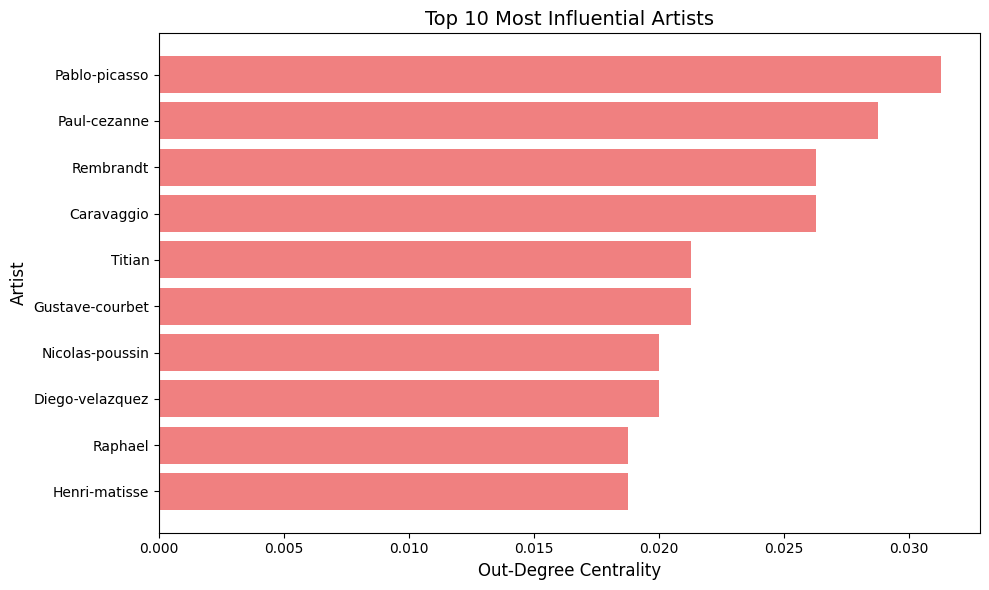

In [ ]:
# Extract artist names and their centrality scores
artist_names = [G.nodes[node].get('name', node).replace('/en/', '').capitalize() for node, _ in top_artists_by_id]
centrality_scores = [centrality for _, centrality in top_artists_by_id]

# Plotting the bar chart
plt.figure(figsize=(10, 6))
plt.barh(artist_names, centrality_scores, color='lightcoral')
plt.gca().invert_yaxis()  # Invert y-axis to have the highest score at the top
plt.xlabel('Out-Degree Centrality', fontsize=12)
plt.ylabel('Artist', fontsize=12)
plt.title('Top 10 Most Influential Artists', fontsize=14)
plt.tight_layout()
plt.show()


### Most inﬂuential Movements

In [ ]:
# Calculate out-degree centrality for all nodes
out_degree_centrality = nx.out_degree_centrality(G)

# Filter for movement nodes only and retrieve their out-degree centrality
movement_centrality = {node: centrality for node, centrality in out_degree_centrality.items() if G.nodes[node].get('type') == 'movement'}

# Sort movement nodes by out-degree centrality in descending order
most_influential_movements = sorted(movement_centrality.items(), key=lambda x: x[1], reverse=True)

# Display the top 10 most influential movements with their title (name attribute) and centrality score
top_10_influential_movements = most_influential_movements[:10]
print("Top 10 Most Influential Movements (by out-degree centrality):")
for node, centrality in top_10_influential_movements:
    title = G.nodes[node].get('name', node).replace('/en/artists-by-art-movement/', '').capitalize()
    print(f"{title}: {centrality:.4f}")


Top 10 Most Influential Movements (by out-degree centrality):
Cubism: 0.0138
Byzantine-art: 0.0113
Expressionism: 0.0075
Surrealism: 0.0075
Dada: 0.0063
Impressionism: 0.0063
Gothic-art: 0.0038
Post-impressionism: 0.0038
Dutch-golden-age: 0.0038
Native-art: 0.0038


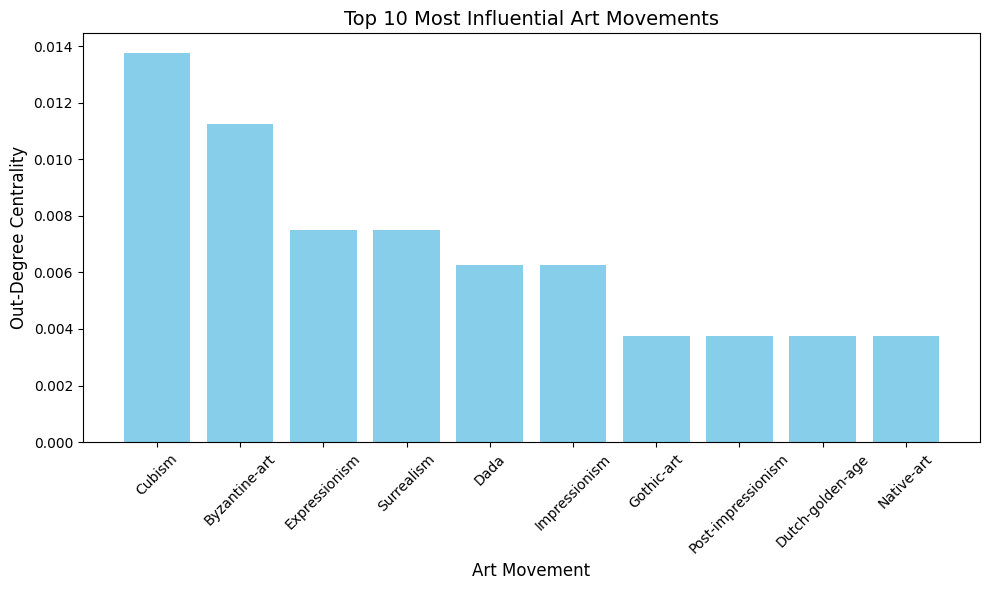

In [ ]:
# Extract movement names and their centrality scores
movement_names = [G.nodes[node].get('name', node).replace('/en/artists-by-art-movement/', '').capitalize() for node, _ in top_10_influential_movements]
centrality_scores = [centrality for _, centrality in top_10_influential_movements]

# Plotting the bar chart
plt.figure(figsize=(10, 6))
plt.bar(movement_names, centrality_scores, color='skyblue')
# plt.gca().invert_yaxis()  # Invert y-axis to have the highest score at the top
plt.xlabel('Art Movement', fontsize=12)
plt.ylabel('Out-Degree Centrality', fontsize=12)
plt.title('Top 10 Most Influential Art Movements', fontsize=14)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


### Most inﬂuential Schools

In [ ]:
# Calculate out-degree centrality for all nodes
out_degree_centrality = nx.out_degree_centrality(G)

# Filter for school nodes only and retrieve their out-degree centrality
school_centrality = {node: centrality for node, centrality in out_degree_centrality.items() if G.nodes[node].get('type') == 'school'}

# Sort school nodes by out-degree centrality in descending order
most_influential_schools = sorted(school_centrality.items(), key=lambda x: x[1], reverse=True)

# Display the top 10 most influential schools with their title (name attribute) and centrality score
top_10_influential_schools = most_influential_schools[:10]
print("Top 10 Most Influential Schools (by out-degree centrality):")
for node, centrality in top_10_influential_schools:
    title = G.nodes[node].get('name', node).replace('/en/artists-by-painting-school/', '').capitalize()
    print(f"{title}: {centrality:.4f}")

Top 10 Most Influential Schools (by out-degree centrality):
Pre-raphaelite-brotherhood: 0.0125
Barbizon-school: 0.0113
Les-fauves: 0.0088
Florentine-school: 0.0050
Venetian-school: 0.0038
Caravaggisti: 0.0025
Die-br-cke-the-bridge: 0.0025
Flemish-school: 0.0025
Sienese-school: 0.0013
La-ruche: 0.0013


### Initialize an Undirected Graph

In [ ]:
G2 = nx.Graph()

### Add the nodes

In [ ]:
for _, row in artists_df.iterrows():
    artist_url = row['artistUrl']  # Unique identifier for the artist

    # Add the artist node with all relevant attributes
    G2.add_node(
        artist_url,  # artistUrl as a unique identifier for the artist
        type='artist',
        nation=row['nation'],
        total_artworks=row['totalWorksTitle'],
        active_years=row['year'],
        image_url=row['image'],
        id=row['id'],
        title=row['title'],
        url=artist_url
    )

unique_institutions = set()
for _, row in relationships_df.iterrows():
    institutions = parse_relationships(row['institution'])
    for item in institutions:
      unique_institutions.add(item)

# Add each unique institution as a node in the graph
for institution in unique_institutions:
    G2.add_node(institution, type='institution', name=institution)


unique_schools = set()
for _, row in relationships_df.iterrows():
    schools = parse_relationships(row['school'])
    for item in schools:
      unique_schools.add(item)

# Add each unique school as a node in the graph
for school in unique_schools:
    G2.add_node(school, type='school', name=school)


unique_movements = set()
for _, row in relationships_df.iterrows():
    movements = parse_relationships(row['movements'])
    for item in movements:
      unique_movements.add(item)

# Add each unique movement as a node in the graph
for movement in unique_movements:
    G2.add_node(movement, type='movement', name=movement)


### Add the edges

In [ ]:
# Add edges based on influence relationships in relationships.csv
for _, row in relationships_df.iterrows():
    artist_id = row['artistUrl']

    # Process the "institution" column
    institutions_attended = parse_relationships(row['institution'])  # Split and clean the institution column
    for institution in institutions_attended:
        if G2.has_node(institution):  # Check if the institution node already exists in the graph
            # Add a edge from institution to artist_id
            G2.add_edge(artist_id, institution, relationship='institution')

    # Process the "school" column
    schools_attended = parse_relationships(row['school'])  # Split and clean the school column
    for school in schools_attended:
        if G2.has_node(school):  # Check if the school node already exists in the graph
            # Add a edge from school to artist_id
            G2.add_edge(artist_id, school, relationship='school')

    # Process the "movement" column
    movements_attended = parse_relationships(row['movements'])  # Split and clean the movement column
    for movement in movements_attended:
        if G2.has_node(movement):  # Check if the movement node already exists in the graph
            # Add a edge from movement to artist_id
            G2.add_edge(artist_id, movement, relationship='movement')


### Draw the graph

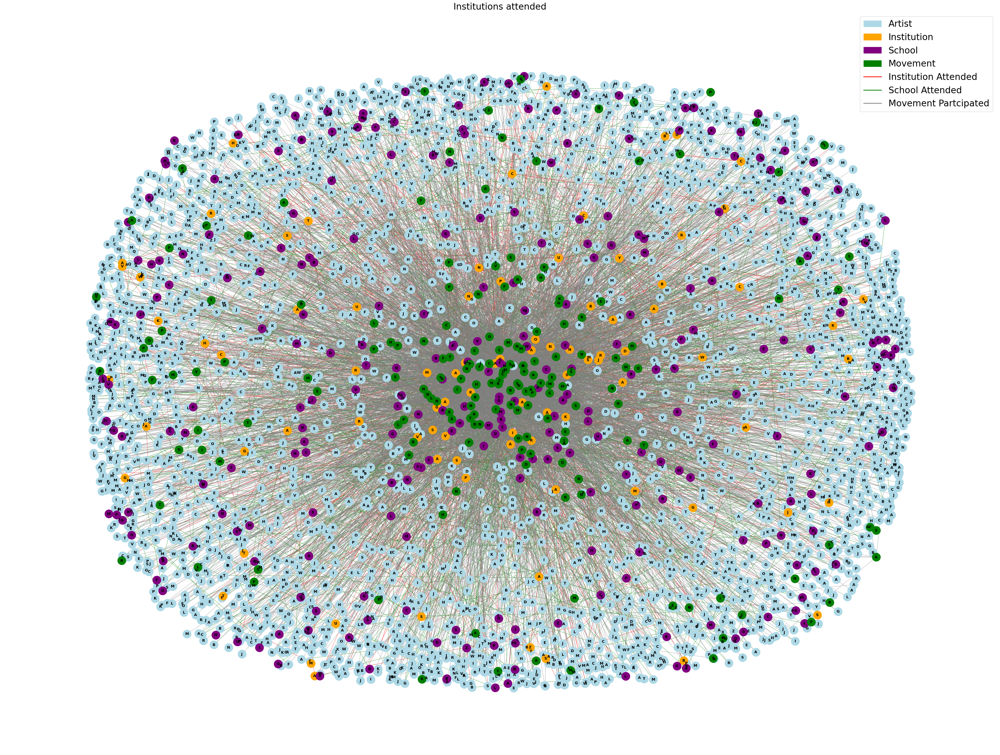

In [ ]:
# Use spring layout for better visualization of relationships
pos = nx.spring_layout(G2, k=0.15, iterations=20)
plt.figure(figsize=(48, 36))

# Separate nodes by type
artist_nodes = [node for node, data in G2.nodes(data=True) if data.get('type') == 'artist']
institution_nodes = [node for node, data in G2.nodes(data=True) if data.get('type') == 'institution']
school_nodes = [node for node, data in G2.nodes(data=True) if data.get('type') == 'school']
movement_nodes = [node for node, data in G2.nodes(data=True) if data.get('type') == 'movement']

# Draw nodes by type with distinct colors
nx.draw_networkx_nodes(G2, pos, nodelist=artist_nodes, node_color='lightblue', node_size=500, label="Artist")
nx.draw_networkx_nodes(G2, pos, nodelist=institution_nodes, node_color='orange', node_size=500, label="Institution")
nx.draw_networkx_nodes(G2, pos, nodelist=school_nodes, node_color='purple', node_size=500, label="School")
nx.draw_networkx_nodes(G2, pos, nodelist=movement_nodes, node_color='green', node_size=500, label="Movement")

# Separate edges by relationship type
institution_edges = [(u, v) for u, v, d in G2.edges(data=True) if d.get('relationship') == 'institution']
school_edges = [(u, v) for u, v, d in G2.edges(data=True) if d.get('relationship') == 'school']
movement_edges = [(u, v) for u, v, d in G2.edges(data=True) if d.get('relationship') == 'movement']

# Draw edges by type with different colors
nx.draw_networkx_edges(G2, pos, edgelist=institution_edges, edge_color='red', width=0.5, arrows=True, arrowsize=15, label="Institution Attended")
nx.draw_networkx_edges(G2, pos, edgelist=school_edges, edge_color='green', width=0.5, arrows=True, arrowsize=15, label="School Attended")
nx.draw_networkx_edges(G2, pos, edgelist=movement_edges, edge_color='grey', width=0.5, arrows=True, arrowsize=15, label="Movement Participated")

# Prepare labels based on node type
labels = {}
for node in artist_nodes:
    labels[node] = node.replace('/en/', '').capitalize()[0]  # First character for artist names
for node in institution_nodes:
    labels[node] = node.replace('/en/artists-by-art-institution/', '').capitalize()[0]  # First character for school names
for node in school_nodes:
    labels[node] = node.replace('/en/artists-by-painting-school/', '').capitalize()[0]
for node in movement_nodes:
    labels[node] = node.replace('/en/artists-by-art-movement/', '').capitalize()[0]

# Draw labels
nx.draw_networkx_labels(G2, pos, labels, font_size=10, font_weight='bold')

# Create legend with circular patches for nodes and line patches for edges
legend_elements = [
    mpatches.Circle((0, 0), radius=0.15, color='lightblue', label='Artist'),
    mpatches.Circle((0, 0), radius=0.15, color='orange', label='Institution'),
    mpatches.Circle((0, 0), radius=0.15, color='purple', label='School'),
    mpatches.Circle((0, 0), radius=0.15, color='Green', label='Movement'),
    Line2D([0], [0], color='red', lw=2, label='Institution Attended'),
    Line2D([0], [0], color='green', lw=2, label='School Attended'),
    Line2D([0], [0], color='grey', lw=2, label='Movement Partcipated')
]

# Add legend to the plot
plt.legend(handles=legend_elements, loc="upper right", fontsize=24)

plt.title("Institutions attended", fontsize=24)
plt.axis('off')
plt.show()


### Most inﬂuential institutions where the majority of artists were part of

In [ ]:
# Calculate out-degree centrality for all nodes
degree_centrality = nx.degree_centrality(G2)

# Filter for institution nodes only and retrieve their out-degree centrality
institution_centrality = {node: centrality for node, centrality in degree_centrality.items() if G2.nodes[node].get('type') == 'institution'}

# Sort institution nodes by degree centrality in descending order
most_influential_institutions = sorted(institution_centrality.items(), key=lambda x: x[1], reverse=True)

# Display the top 10 most influential institutions with their title and centrality score
top_10_influential_institutions = most_influential_institutions[:10]
print("Top 10 Most Influential Institurions (by degree centrality):")
for node, centrality in top_10_influential_institutions:
    title = G2.nodes[node].get('name', node).replace('/en/artists-by-art-institution/', '').capitalize()
    print(f"{title}: {centrality:.4f}")


Top 10 Most Influential Institurions (by degree centrality):
Cole-des-beaux-arts: 0.0229
Acad-mie-julian: 0.0150
Art-students-league: 0.0144
Akademie-der: 0.0102
Imperial-academy-of-arts-saint-petersburg-russia: 0.0099
Guild-of-saint-luke: 0.0088
Royal-academy-of: 0.0082
National-academy: 0.0074
National-academy-of-visual-arts-and-architecture: 0.0071
Kunstakademie-dusseldorf-dusseldorf-germany: 0.0065


### Top nationalities where the majority of artists concentrate

In [ ]:
# Count the nationalities of artist nodes in the graph
nationality_counts = Counter()

for n in G2.nodes:
    if G2.nodes[n].get('type') == 'artist':  # Check if the node is an artist
        nationality = G2.nodes[n].get('nation')
        nationality_counts[nationality] += 1

# Get the top 10 nationalities by count
top_nationalities = nationality_counts.most_common(10)

# Print the top 10 nationalities
print("\nTop nationalities by artist count:")
for i, (nationality, count) in enumerate(top_nationalities, 1):
    print(f"{i}. {nationality}: {count}")


Top nationalities by artist count:
1. American: 520
2. French: 402
3. Italian: 269
4. British: 249
5. German: 160
6. Russian: 108
7. Dutch: 105
8. Spanish: 87
9. Romanian: 78
10. Japanese: 67


### Biggest communities in the network

In [51]:
# Calculate Eigenvector Centrality
eigenvector_centrality = nx.eigenvector_centrality(G2)

# Set Eigenvector Centrality as Node Attribute
nx.set_node_attributes(G2, eigenvector_centrality, 'eigenvector')

# Detect communities using the greedy modularity algorithm
communities = list(community.greedy_modularity_communities(G2))

# Display the largest communities by size
community_sizes = sorted([len(c) for c in communities], reverse=True)
print("\nLargest communities by size:", community_sizes[:10])



Largest communities by size: [504, 429, 408, 373, 332, 331, 317, 200, 179, 137]


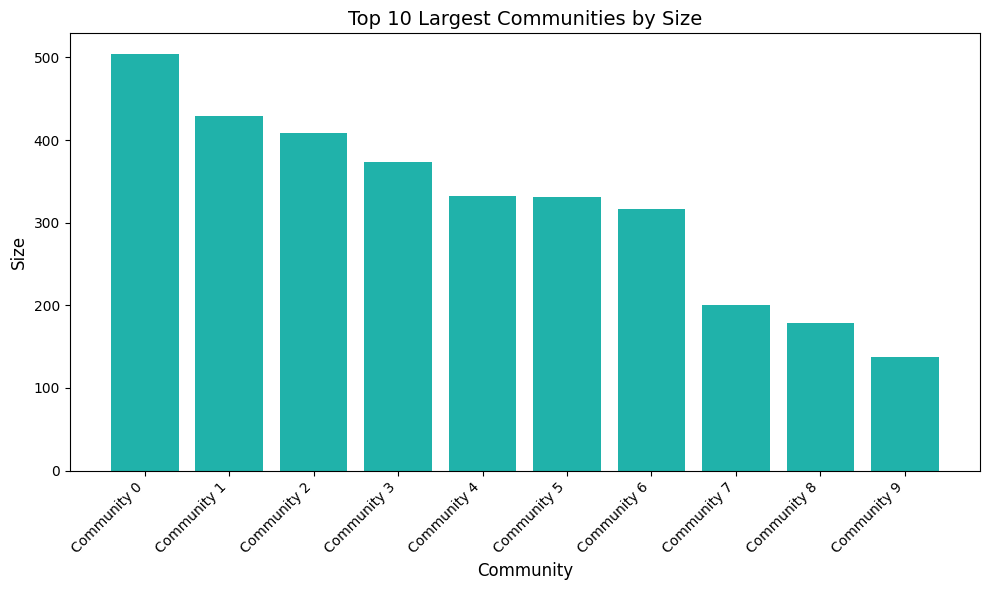

In [ ]:
# Community sizes and corresponding labels
community_labels = [f"Community {i}" for i in range(10)]
community_sizes = community_sizes[:10]  # Get the sizes of the top 10 largest communities

# Plotting the vertical bar chart
plt.figure(figsize=(10, 6))
plt.bar(community_labels, community_sizes, color='lightseagreen')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels 45 degrees
plt.xlabel('Community', fontsize=12)
plt.ylabel('Size', fontsize=12)
plt.title('Top 10 Largest Communities by Size', fontsize=14)
plt.tight_layout()
plt.show()

### Interactive Graphs
* To see the interactive graphs, download the newly generated HTML files or from moodle, and open them in your any prefered broser
* It will take some time to render and load the HTML files in the browser

### Interactive form of the Directed Graph (G) shown above

In [ ]:
from pyvis.network import Network

# Initialize Pyvis Network
net = Network(notebook=True, height="750px", width="100%", cdn_resources='in_line')

# Add nodes and customize colors based on the logic
for node, data in G.nodes(data=True):
    node_type = data.get('type')
    color = 'lightblue' if node_type == 'artist' else \
            'orange' if node_type == 'school' else \
            'purple' if node_type == 'movement' else 'gray'
    net.add_node(node, color=color, title=node)

# Add edges and customize colors based on relationship
for u, v, data in G.edges(data=True):
    color = 'green' if data.get('relationship') == 'influenced_by' else \
            'red' if data.get('relationship') == 'influenced_on' else 'black'
    net.add_edge(u, v, color=color)

net.show("art_network_G01_interactive.html")



art_network_G01_interactive.html


### Interactive form of the Undirected Graph (G2) shown above

In [ ]:
from pyvis.network import Network

# Initialize Pyvis Network
net = Network(notebook=True, height="750px", width="100%", cdn_resources='in_line')

# Add nodes and customize colors
for node, data in G2.nodes(data=True):
    node_type = data.get('type')
    color = 'lightblue' if node_type == 'artist' else \
            'orange' if node_type == 'institution' else \
            'purple' if node_type == 'school' else \
            'green' if node_type == 'movement' else 'gray'
    net.add_node(node, color=color, title=node)

# Add edges and customize colors based on relationship
for u, v, data in G2.edges(data=True):
    color = 'red' if data.get('relationship') == 'institution' else \
            'green' if data.get('relationship') == 'school' else \
            'grey' if data.get('relationship') == 'movement' else 'black'
    net.add_edge(u, v, color=color)

# Generate and display the interactive network
net.show("art_network_G02_interactive.html")


art_network_G02_interactive.html
